In [2]:
pip install geopandas matplotlib descartes

In [3]:
from google.colab import drive
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import geopandas as gpd
from mpl_toolkits.axes_grid1 import make_axes_locatable
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler



# Mount Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


# 1. Import Merged_Agri_Climate_Eco_Data csv file.

In [4]:
# Define the file path
file_path = "/content/drive/My Drive/GoodNotes/Merged File for Analysis/Merged_Agri_Climate_Eco_Data.csv"

merged_agri_climate_eco_df = pd.read_csv(file_path)
merged_agri_climate_eco_df

,State,Year,GDP (Millions of dollars),Population (Number of persons),Personal Income (Dollars),Total Civilian Non-Institutional Population in State/Area,Total Civilian Labor Force in State/Area,Percent (%) of State/Area's Population,Total Employment in State/Area,Percent (%) of Labor Force Employed in State/Area,...,Qv2M,Rh2M,T2Mdew,T2Mwet,Toa_Sw_Dwn,Ts,Wd10M,Wd2M,Ws10M,Ws2M
0,alabama,2022,258362.2,5073903,50920,4.013691e+06,2.286026e+06,56.958333,2.226687e+06,55.466667,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
1,alabama,2022,258362.2,5073903,50920,4.013691e+06,2.286026e+06,56.958333,2.226687e+06,55.466667,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
2,alabama,2022,258362.2,5073903,50920,4.013691e+06,2.286026e+06,56.958333,2.226687e+06,55.466667,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
3,alabama,2021,252791.9,5050380,50054,3.989929e+06,2.259433e+06,56.633333,2.183167e+06,54.716667,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
4,alabama,2021,252791.9,5050380,50054,3.989929e+06,2.259433e+06,56.633333,2.183167e+06,54.716667,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5260,wyoming,2022,42584.7,581629,73216,4.578948e+05,2.917211e+05,63.708333,2.813323e+05,61.433333,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5261,wyoming,2022,42584.7,581629,73216,4.578948e+05,2.917211e+05,63.708333,2.813323e+05,61.433333,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5262,wyoming,2020,37866.4,577664,65551,4.506268e+05,2.937358e+05,65.200000,2.763883e+05,61.333333,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90
5263,wyoming,2020,37866.4,577664,65551,4.506268e+05,2.937358e+05,65.200000,2.763883e+05,61.333333,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90


In [5]:
# Convert GDP unit from millions to dollars
if 'GDP (Millions of dollars)' in merged_agri_climate_eco_df.columns:
    merged_agri_climate_eco_df['GDP (Millions of dollars)'] *= 1_000_000

# Rename the column
merged_agri_climate_eco_df.rename(columns={'GDP (Millions of dollars)': 'GDP (dollars)'}, inplace=True)

merged_agri_climate_eco_df

,State,Year,GDP (dollars),Population (Number of persons),Personal Income (Dollars),Total Civilian Non-Institutional Population in State/Area,Total Civilian Labor Force in State/Area,Percent (%) of State/Area's Population,Total Employment in State/Area,Percent (%) of Labor Force Employed in State/Area,...,Qv2M,Rh2M,T2Mdew,T2Mwet,Toa_Sw_Dwn,Ts,Wd10M,Wd2M,Ws10M,Ws2M
0,alabama,2022,2.583622e+11,5073903,50920,4.013691e+06,2.286026e+06,56.958333,2.226687e+06,55.466667,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
1,alabama,2022,2.583622e+11,5073903,50920,4.013691e+06,2.286026e+06,56.958333,2.226687e+06,55.466667,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
2,alabama,2022,2.583622e+11,5073903,50920,4.013691e+06,2.286026e+06,56.958333,2.226687e+06,55.466667,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
3,alabama,2021,2.527919e+11,5050380,50054,3.989929e+06,2.259433e+06,56.633333,2.183167e+06,54.716667,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
4,alabama,2021,2.527919e+11,5050380,50054,3.989929e+06,2.259433e+06,56.633333,2.183167e+06,54.716667,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5260,wyoming,2022,4.258470e+10,581629,73216,4.578948e+05,2.917211e+05,63.708333,2.813323e+05,61.433333,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5261,wyoming,2022,4.258470e+10,581629,73216,4.578948e+05,2.917211e+05,63.708333,2.813323e+05,61.433333,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5262,wyoming,2020,3.786640e+10,577664,65551,4.506268e+05,2.937358e+05,65.200000,2.763883e+05,61.333333,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90
5263,wyoming,2020,3.786640e+10,577664,65551,4.506268e+05,2.937358e+05,65.200000,2.763883e+05,61.333333,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90


In [6]:
# Define the column name mappings
rename_columns = {
    'Percent (%) of State/Area\'s Population': 'State_Area_Population_Rate',
    'Percent (%) of Labor Force Employed in State/Area': 'Labor_Force_Employed_Rate',
    'Percent (%) of Labor Force Unemployed in State/Area': 'Labor_Force_Unemployed_Rate'
}

# Rename the columns
merged_agri_climate_eco_df = merged_agri_climate_eco_df.rename(columns=rename_columns)

# Convert the percentage columns to decimal format
percent_columns = list(rename_columns.values())
merged_agri_climate_eco_df[percent_columns] = merged_agri_climate_eco_df[percent_columns] / 100

# Set display precision to 2 decimal places
pd.set_option('display.float_format', '{:.2f}'.format)

# Display the updated DataFrame to verify changes
merged_agri_climate_eco_df

,State,Year,GDP (dollars),Population (Number of persons),Personal Income (Dollars),Total Civilian Non-Institutional Population in State/Area,Total Civilian Labor Force in State/Area,State_Area_Population_Rate,Total Employment in State/Area,Labor_Force_Employed_Rate,...,Qv2M,Rh2M,T2Mdew,T2Mwet,Toa_Sw_Dwn,Ts,Wd10M,Wd2M,Ws10M,Ws2M
0,alabama,2022,258362200000.00,5073903,50920,4013691.08,2286026.08,0.57,2226687.33,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
1,alabama,2022,258362200000.00,5073903,50920,4013691.08,2286026.08,0.57,2226687.33,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
2,alabama,2022,258362200000.00,5073903,50920,4013691.08,2286026.08,0.57,2226687.33,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
3,alabama,2021,252791900000.00,5050380,50054,3989929.42,2259433.33,0.57,2183166.58,0.55,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
4,alabama,2021,252791900000.00,5050380,50054,3989929.42,2259433.33,0.57,2183166.58,0.55,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5260,wyoming,2022,42584700000.00,581629,73216,457894.83,291721.08,0.64,281332.33,0.61,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5261,wyoming,2022,42584700000.00,581629,73216,457894.83,291721.08,0.64,281332.33,0.61,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5262,wyoming,2020,37866400000.00,577664,65551,450626.83,293735.75,0.65,276388.33,0.61,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90
5263,wyoming,2020,37866400000.00,577664,65551,450626.83,293735.75,0.65,276388.33,0.61,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90


In [7]:
# Shorten the column names for very long columns while retaining the units in a shorter form
shortened_columns = {
    'GDP (dollars)': 'GDP ($)',
    'Population (Number of persons)': 'Population',
    'Personal Income (Dollars)': 'Income ($)',
    'Total Civilian Non-Institutional Population in State/Area': 'Civilian Non-Institutional Pop in State',
    'Total Civilian Labor Force in State/Area': 'Labor Force in State',
    'State_Area_Population_Rate': 'State Area Pop Rate',
    'Total Employment in State/Area': 'Employment in State',
    'Labor_Force_Employed_Rate': 'Employed Rate',
    'Total Unemployment in State/Area': 'Unemployment in State',
    'Labor_Force_Unemployed_Rate': 'Unemployed Rate',
    'ACRES HARVESTED': 'Acres Harvested',
    'PRODUCTION, MEASURED IN $': 'Production ($)',
    'YIELD': 'Yield',
    'January-December Average Temperature (Units Degrees Fahrenheit)': 'Avg Temp (°F)',
    'January-December Cooling Degree Days (Units Fahrenheit Degree-Days)': 'Cooling Days (°F)',
    'January-December Heating Degree Days (Units Fahrenheit Degree-Days)': 'Heating Days (°F)',
    'January-December Maximum Temperature (Units Degrees Fahrenheit)': 'Max Temp (°F)',
    'January-December Minimum Temperature (Units Degrees Fahrenheit)': 'Min Temp (°F)',
    'August Palmer Drought Severity Index (PDSI)': 'PDSI',
    'August Palmer Hydrological Drought Index (PHDI)': 'PHDI',
    'August Palmer Modified Drought Index (PMDI)': 'PMDI',
    'January-December Palmer Z-Index': 'Z-Index',
    'January-December Precipitation (Units Inches)': 'Precipitation (Inches)',
    'Allsky_Sfc_Sw_Dwn': 'Allsky Sfc Sw Dwn',
    'Allsky_Srf_Alb': 'Allsky Srf Alb',
    'Cloud_Amt': 'Cloud Amt',
    'Clrsky_Sfc_Sw_Dwn': 'Clrsky Sfc Sw Dwn',
    'Gwetprof': 'Gwetprof',
    'Gwetroot': 'Gwetroot',
    'Gwettop': 'Gwettop',
    'Ps': 'Ps',
    'Qv2M': 'Qv2M',
    'Rh2M': 'Rh2M',
    'T2Mdew': 'T2Mdew',
    'T2Mwet': 'T2Mwet',
    'Toa_Sw_Dwn': 'Toa Sw Dwn',
    'Ts': 'Ts',
    'Wd10M': 'Wd10M',
    'Wd2M': 'Wd2M',
    'Ws10M': 'Ws10M',
    'Ws2M': 'Ws2M'
}

# Rename the columns in the dataframe
merged_agri_climate_eco_df.rename(columns=shortened_columns, inplace=True)


merged_agri_climate_eco_df

,State,Year,GDP ($),Population,Income ($),Civilian Non-Institutional Pop in State,Labor Force in State,State Area Pop Rate,Employment in State,Employed Rate,...,Qv2M,Rh2M,T2Mdew,T2Mwet,Toa Sw Dwn,Ts,Wd10M,Wd2M,Ws10M,Ws2M
0,alabama,2022,258362200000.00,5073903,50920,4013691.08,2286026.08,0.57,2226687.33,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
1,alabama,2022,258362200000.00,5073903,50920,4013691.08,2286026.08,0.57,2226687.33,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
2,alabama,2022,258362200000.00,5073903,50920,4013691.08,2286026.08,0.57,2226687.33,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
3,alabama,2021,252791900000.00,5050380,50054,3989929.42,2259433.33,0.57,2183166.58,0.55,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
4,alabama,2021,252791900000.00,5050380,50054,3989929.42,2259433.33,0.57,2183166.58,0.55,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5260,wyoming,2022,42584700000.00,581629,73216,457894.83,291721.08,0.64,281332.33,0.61,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5261,wyoming,2022,42584700000.00,581629,73216,457894.83,291721.08,0.64,281332.33,0.61,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5262,wyoming,2020,37866400000.00,577664,65551,450626.83,293735.75,0.65,276388.33,0.61,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90
5263,wyoming,2020,37866400000.00,577664,65551,450626.83,293735.75,0.65,276388.33,0.61,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90


# 2. Data Preprocessing before EDA.

## 2.1 Handling Missing Values

In [8]:
merged_agri_climate_eco_df.isnull().sum()

,0
State,0
Year,0
GDP ($),0
Population,0
Income ($),0
Civilian Non-Institutional Pop in State,0
Labor Force in State,0
State Area Pop Rate,0
Employment in State,0
Employed Rate,0


In [9]:
# Delete all columns with more than 2000 NaNs
cols_to_drop = merged_agri_climate_eco_df.columns[merged_agri_climate_eco_df.isnull().sum() > 2000]
merged_agri_climate_eco_df.drop(columns=cols_to_drop, inplace=True)

# Delete all rows with any NaN values
merged_agri_climate_eco_df.dropna(inplace=True)

merged_agri_climate_eco_df

,State,Year,GDP ($),Population,Income ($),Civilian Non-Institutional Pop in State,Labor Force in State,State Area Pop Rate,Employment in State,Employed Rate,...,Qv2M,Rh2M,T2Mdew,T2Mwet,Toa Sw Dwn,Ts,Wd10M,Wd2M,Ws10M,Ws2M
0,alabama,2022,258362200000.00,5073903,50920,4013691.08,2286026.08,0.57,2226687.33,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
1,alabama,2022,258362200000.00,5073903,50920,4013691.08,2286026.08,0.57,2226687.33,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
2,alabama,2022,258362200000.00,5073903,50920,4013691.08,2286026.08,0.57,2226687.33,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
3,alabama,2021,252791900000.00,5050380,50054,3989929.42,2259433.33,0.57,2183166.58,0.55,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
4,alabama,2021,252791900000.00,5050380,50054,3989929.42,2259433.33,0.57,2183166.58,0.55,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5260,wyoming,2022,42584700000.00,581629,73216,457894.83,291721.08,0.64,281332.33,0.61,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5261,wyoming,2022,42584700000.00,581629,73216,457894.83,291721.08,0.64,281332.33,0.61,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5262,wyoming,2020,37866400000.00,577664,65551,450626.83,293735.75,0.65,276388.33,0.61,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90
5263,wyoming,2020,37866400000.00,577664,65551,450626.83,293735.75,0.65,276388.33,0.61,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90


In [10]:
merged_agri_climate_eco_df.isnull().sum()

,0
State,0
Year,0
GDP ($),0
Population,0
Income ($),0
Civilian Non-Institutional Pop in State,0
Labor Force in State,0
State Area Pop Rate,0
Employment in State,0
Employed Rate,0


## 2.2 Data Types and Consistency

In [11]:
merged_agri_climate_eco_df.dtypes

,0
State,object
Year,int64
GDP ($),float64
Population,int64
Income ($),int64
Civilian Non-Institutional Pop in State,float64
Labor Force in State,float64
State Area Pop Rate,float64
Employment in State,float64
Employed Rate,float64


In [12]:
# Convert columns to integer
integer_columns = ['Year', 'GDP ($)', 'Population', 'Income ($)',
                   'Civilian Non-Institutional Pop in State', 'Labor Force in State',
                   'Employment in State', 'Unemployment in State',
                   'Cooling Days (°F)', 'Heating Days (°F)']

# Handling non-integer values (if any) by filling NaNs with a placeholder or using rounding
merged_agri_climate_eco_df[integer_columns] = merged_agri_climate_eco_df[integer_columns].apply(pd.to_numeric, errors='coerce').fillna(0).astype(int)
merged_agri_climate_eco_df

,State,Year,GDP ($),Population,Income ($),Civilian Non-Institutional Pop in State,Labor Force in State,State Area Pop Rate,Employment in State,Employed Rate,...,Qv2M,Rh2M,T2Mdew,T2Mwet,Toa Sw Dwn,Ts,Wd10M,Wd2M,Ws10M,Ws2M
0,alabama,2022,258362200000,5073903,50920,4013691,2286026,0.57,2226687,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
1,alabama,2022,258362200000,5073903,50920,4013691,2286026,0.57,2226687,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
2,alabama,2022,258362200000,5073903,50920,4013691,2286026,0.57,2226687,0.55,...,9.95,73.81,11.90,14.68,30.85,17.37,199.56,256.62,1.94,0.25
3,alabama,2021,252791900000,5050380,50054,3989929,2259433,0.57,2183166,0.55,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
4,alabama,2021,252791900000,5050380,50054,3989929,2259433,0.57,2183166,0.55,...,10.44,77.56,12.90,15.19,30.84,17.38,195.88,203.88,1.95,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5260,wyoming,2022,42584700000,581629,73216,457894,291721,0.64,281332,0.61,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5261,wyoming,2022,42584700000,581629,73216,457894,291721,0.64,281332,0.61,...,4.46,56.44,-2.70,2.08,27.11,7.12,252.00,254.88,4.23,2.90
5262,wyoming,2020,37866400000,577664,65551,450626,293735,0.65,276388,0.61,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90
5263,wyoming,2020,37866400000,577664,65551,450626,293735,0.65,276388,0.61,...,4.27,55.56,-2.75,2.19,27.06,7.32,247.00,249.44,4.27,2.90


In [13]:
merged_agri_climate_eco_df.dtypes

,0
State,object
Year,int64
GDP ($),int64
Population,int64
Income ($),int64
Civilian Non-Institutional Pop in State,int64
Labor Force in State,int64
State Area Pop Rate,float64
Employment in State,int64
Employed Rate,float64


## 2.3 Outlier Detection and Handling.

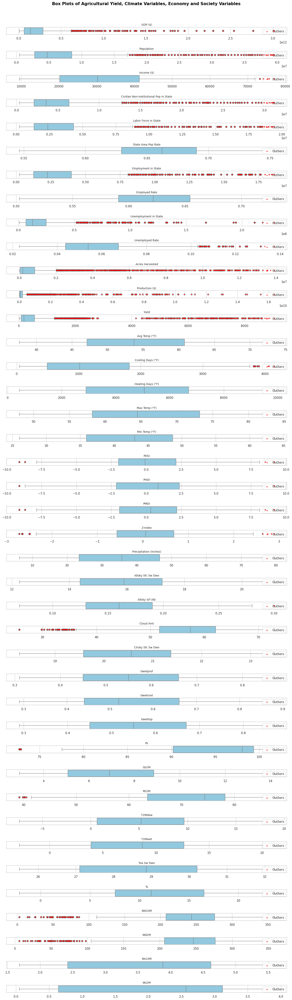

In [14]:
# Define columns to be checked for outliers
columns_to_check = ['GDP ($)',
                    'Population',
                    'Income ($)',
                    'Civilian Non-Institutional Pop in State',
                    'Labor Force in State',
                    'State Area Pop Rate',
                    'Employment in State',
                    'Employed Rate',
                    'Unemployment in State',
                    'Unemployed Rate',
                    'Acres Harvested',
                    'Production ($)',
                    'Yield',
                    'Avg Temp (°F)',
                    'Cooling Days (°F)',
                    'Heating Days (°F)',
                    'Max Temp (°F)',
                    'Min Temp (°F)',
                    'PDSI',
                    'PHDI',
                    'PMDI',
                    'Z-Index',
                    'Precipitation (Inches)',
                    'Allsky Sfc Sw Dwn',
                    'Allsky Srf Alb',
                    'Cloud Amt',
                    'Clrsky Sfc Sw Dwn',
                    'Gwetprof',
                    'Gwetroot',
                    'Gwettop',
                    'Ps',
                    'Qv2M',
                    'Rh2M',
                    'T2Mdew',
                    'T2Mwet',
                    'Toa Sw Dwn',
                    'Ts',
                    'Wd10M',
                    'Wd2M',
                    'Ws10M',
                    'Ws2M']

# Function to detect outliers using IQR method
def detect_outliers_iqr(data):
    Q1 = data.quantile(0.25)
    Q3 = data.quantile(0.75)
    IQR = Q3 - Q1
    outliers = ((data < (Q1 - 1.5 * IQR)) | (data > (Q3 + 1.5 * IQR)))
    return outliers

# Set up the matplotlib figure
num_columns = 1  # Single column layout for vertical arrangement
num_rows = len(columns_to_check)  # Number of rows equal to the number of columns

plt.figure(figsize=(15, num_rows * 1.3))  # Adjust figure size for better visibility
plt.suptitle('Box Plots of Agricultural Yield, Climate Variables, Economy and Society Variables', fontsize=15, fontweight='bold')

# Set a style for the plots
sns.set(style="whitegrid")

# Create a box plot for each column
for i, column in enumerate(columns_to_check, 1):
    plt.subplot(num_rows, num_columns, i)  # Vertical layout
    sns.boxplot(x=merged_agri_climate_eco_df[column], color='skyblue', width=0.3)

    # Detect outliers
    outliers = detect_outliers_iqr(merged_agri_climate_eco_df[column])

    # Highlight outliers
    outlier_points = merged_agri_climate_eco_df[column][outliers]
    plt.scatter(outlier_points, [0] * len(outlier_points), color='red', s=6, zorder=10, label='Outliers')

    plt.title(column, fontsize=10, wrap=True)  # Title with wrapping
    plt.xlabel('')  # Remove x-axis label to reduce clutter
    plt.ylabel('')  # Remove y-axis label to reduce clutter
    plt.legend(loc='upper right')  # Add legend for outliers

plt.tight_layout(rect=[0, 0.03, 1, 0.97])  # Adjust layout to fit titles and prevent overlap
plt.show()


# 3. Univariate Analysis

## 3.0 Descriptive Statistics

In [15]:
merged_agri_climate_eco_df.describe()

,Year,GDP ($),Population,Income ($),Civilian Non-Institutional Pop in State,Labor Force in State,State Area Pop Rate,Employment in State,Employed Rate,Unemployment in State,...,Qv2M,Rh2M,T2Mdew,T2Mwet,Toa Sw Dwn,Ts,Wd10M,Wd2M,Ws10M,Ws2M
count,4680.00,4680.00,4680.00,4680.00,4680.00,4680.00,4680.00,4680.00,4680.00,4680.00,...,4680.00,4680.00,4680.00,4680.00,4680.00,4680.00,4680.00,4680.00,4680.00,4680.00
mean,2002.46,262819634572.63,7452838.53,31823.43,5672019.65,3698287.01,0.66,3473480.48,0.62,224806.05,...,7.13,70.01,5.16,8.43,28.70,11.67,234.81,234.20,3.58,2.07
std,11.08,383153226106.81,8177973.13,13728.49,6207885.23,3994903.25,0.04,3728337.96,0.04,291647.99,...,2.39,11.07,5.86,5.38,1.76,5.49,54.36,58.37,1.14,1.20
min,1984.00,6480300000.00,453690.00,9509.00,329521.00,236823.00,0.55,223451.00,0.50,7799.00,...,2.93,39.19,-7.38,-2.87,25.50,-2.16,2.81,6.00,1.68,0.05
25%,1993.00,62358700000.00,2783785.00,20219.00,2096381.00,1333986.00,0.63,1247317.00,0.59,66774.00,...,5.07,63.50,0.65,3.87,27.10,7.52,207.56,206.12,2.42,0.64
50%,2002.00,136330200000.00,4735571.00,30220.00,3586138.00,2376726.00,0.66,2244086.00,0.62,125882.00,...,6.90,74.38,5.20,8.71,28.86,11.18,243.25,246.31,3.88,2.57
75%,2012.00,286084300000.00,8508256.00,41315.25,6350716.00,4313332.00,0.69,3981903.25,0.65,247908.50,...,8.85,78.25,9.65,12.64,30.21,16.51,275.50,276.38,4.62,3.12
max,2022.00,3013676900000.00,39547996.00,77013.00,31184333.00,19415065.00,0.75,18620301.00,0.73,2287097.00,...,14.16,87.56,18.95,21.13,32.25,23.61,358.62,357.81,5.59,3.90


## 3.1 Histogram Visualize the distribution of data.

In [16]:
# Define columns for each category
climate_vars = ['Avg Temp (°F)', 'Cooling Days (°F)', 'Heating Days (°F)', 'Max Temp (°F)',
                'Min Temp (°F)', 'PDSI', 'PHDI', 'PMDI', 'Z-Index', 'Precipitation (Inches)',
                'Allsky Sfc Sw Dwn', 'Allsky Srf Alb', 'Cloud Amt', 'Clrsky Sfc Sw Dwn', 'Gwetprof',
                'Gwetroot', 'Gwettop', 'Ps', 'Qv2M', 'Rh2M', 'T2Mdew', 'T2Mwet', 'Toa Sw Dwn',
                'Ts', 'Wd10M', 'Wd2M', 'Ws10M', 'Ws2M']
economic_vars = ['GDP ($)', 'Population', 'Income ($)', 'Civilian Non-Institutional Pop in State',
                 'Labor Force in State', 'State Area Pop Rate', 'Employment in State',
                 'Employed Rate', 'Unemployment in State', 'Unemployed Rate']
agri_vars = ['Acres Harvested', 'Production ($)', 'Yield']


# Function to plot histograms with KDE
def plot_histograms(data, columns, title, y_pos):
    num_columns = 4
    num_rows = len(columns) // num_columns + (len(columns) % num_columns > 0)

    plt.figure(figsize=(14, num_rows * 3))
    plt.suptitle(title, fontsize=14, fontweight='bold', y=y_pos)  # Adjust y position for title

    for i, column in enumerate(columns):
        plt.subplot(num_rows, num_columns, i + 1)
        sns.histplot(data[column], bins=30, kde=True, color='#4682B4')
        plt.title(f'{column}', fontsize=10)
        plt.xlabel('')
        plt.ylabel('Frequency')

    plt.tight_layout(rect=[0, 0.05, 1, y_pos - 0.01])  # Adjust layout to fit suptitle and avoid overlap
    plt.show()


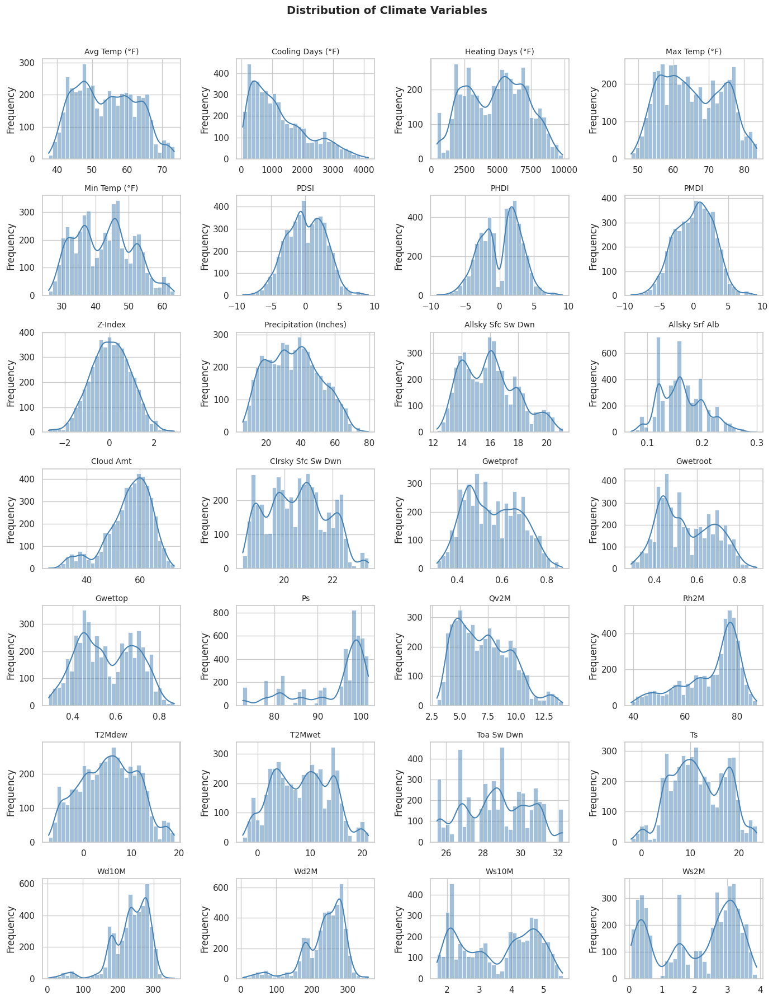

In [17]:
# Plot for climate variables with closer title
plot_histograms(merged_agri_climate_eco_df, climate_vars, "Distribution of Climate Variables", y_pos=0.90)

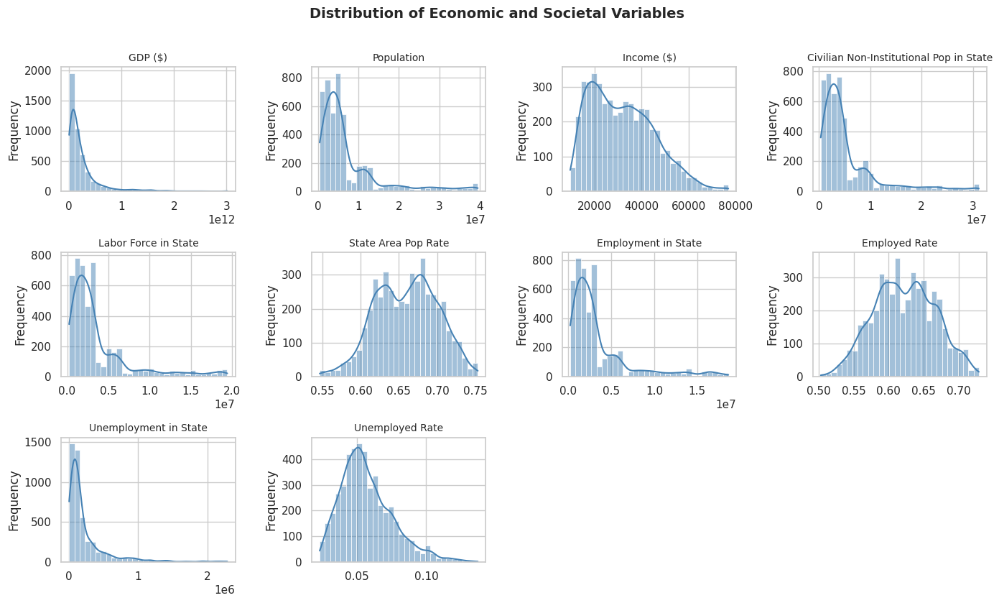

In [18]:
# Plot for economic variables
plot_histograms(merged_agri_climate_eco_df, economic_vars, "Distribution of Economic and Societal Variables", y_pos=0.98)

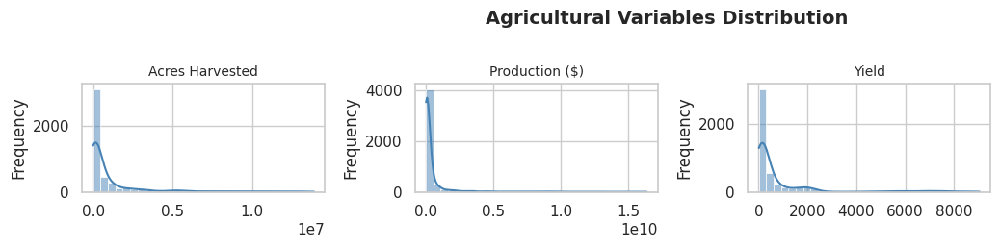

In [19]:
# Plot for agricultural variables
plot_histograms(merged_agri_climate_eco_df, agri_vars, "Agricultural Variables Distribution", y_pos=0.90)

## **3.2 Geographical Plotting - Plot averaged independent variables on the US map.**

In [20]:
shapefile_path = "/content/drive/My Drive/GoodNotes/2023_US_Shapefile/s_05mr24.shp"

In [21]:
merged_agri_climate_eco_df['Commodity'].unique()

array(['WHEAT', 'CORN', 'COTTON', 'POTATOES', 'BEANS', 'RICE', 'TOMATOES'],
      dtype=object)

In [22]:
# Function to plot a choropleth map of average climate variable data by state using GeoPandas
def plot_univariate_variable_map(df, shapefile_path, variable_to_plot, specific_yield=None):
    """
    Function to plot a choropleth map of average climate variable data by state using GeoPandas.

    Parameters:
    - df (DataFrame): DataFrame containing state-level data with columns 'State', 'Year', and climate variables.
    - shapefile_path (str): Path to the US shapefile.
    - variable_to_plot (str): Name of the climate variable to plot.
    - specific_yield (str, optional): If plotting specific yield, provide the yield type. If None, plots the general yield.

    Returns:
    - None (displays the plot).
    """

    agri_cols = ['Acres Harvested', 'Production ($)', 'Yield']
    specific_yield_cols = ['WHEAT', 'CORN', 'COTTON', 'POTATOES', 'BEANS', 'RICE', 'TOMATOES']

    eco_cols = [
        'GDP ($)', 'Population', 'Income ($)',
        'Civilian Non-Institutional Pop in State', 'Labor Force in State',
        'State Area Pop Rate', 'Employment in State', 'Employed Rate',
        'Unemployment in State', 'Unemployed Rate'
    ]

    warm_climate_color_cols = [
        'Max Temp (°F)', 'Heating Days (°F)', 'PDSI', 'PHDI', 'PMDI', 'Z-Index', 'Allsky Sfc Sw Dwn',
        'Clrsky Sfc Sw Dwn', 'Toa Sw Dwn'
    ]

    cold_climate_color_cols = [
        'Min Temp (°F)', 'Cooling Days (°F)', 'Precipitation (Inches)', 'Gwetprof', 'Gwetroot', 'Gwettop',
        'Qv2M', 'Rh2M', 'T2Mdew', 'T2Mwet'
    ]

    neutral_climate_color_cols = [
        'Avg Temp (°F)', 'Allsky Srf Alb', 'Cloud Amt', 'Ps', 'Ts', 'Wd10M', 'Wd2M', 'Ws10M', 'Ws2M'
    ]

    # Determine color map based on the variable
    if variable_to_plot in agri_cols:
        cmap = 'Greens'  # Green for agriculture
    elif variable_to_plot in eco_cols:
        cmap = 'Greys'  # Gray for economic data
    elif variable_to_plot in warm_climate_color_cols:
        cmap = 'OrRd'  # Warm color for warm climate data
    elif variable_to_plot in cold_climate_color_cols:
        cmap = 'Blues'  # Cold color for cold climate data
    elif variable_to_plot in neutral_climate_color_cols:
        cmap = 'YlOrBr'  # Neutral color for neutral climate data
    else:
        cmap = 'viridis'  # Default color map if not specified

    # Convert 'State' column to lowercase for consistency
    df['State'] = df['State'].str.lower()

    if variable_to_plot == 'Yield' and specific_yield is None:
        # Sum yields across all commodities for each state and year
        df = df.groupby(['State', 'Year'])['Yield'].sum().reset_index()
        title = 'Average Total Yield by State 1986-2022'
    elif variable_to_plot == 'Yield' and specific_yield:
        if specific_yield in specific_yield_cols:
            df = df[df['Commodity'] == specific_yield]
            title = f'Average {specific_yield} Yield by State 1986-2022'
        else:
            raise ValueError(f"Specific yield '{specific_yield}' is not recognized. Please choose from {specific_yield_cols}.")
    else:
        title = f'Average {variable_to_plot} by State 1986-2022'

    # Calculate average climate variable per state
    average_climate = df.groupby('State')[variable_to_plot].mean().reset_index()

    # Load US states shapefile into a GeoDataFrame
    us_states = gpd.read_file(shapefile_path)

    # Convert 'NAME' column to lowercase for consistency
    us_states['NAME'] = us_states['NAME'].str.lower()

    # Merge average climate variable data with US states GeoDataFrame
    merged_map_data = pd.merge(us_states, average_climate, left_on='NAME', right_on='State', how='left')

    # Fill NaN values with 0 (in case there are states without climate data)
    merged_map_data[variable_to_plot].fillna(0, inplace=True)

    # Create a larger figure size for the map
    fig, ax = plt.subplots(figsize=(30, 20))  # Increased figure size to make the map larger

    # Plotting the US states map with average climate variable data
    merged_map_data.plot(column=variable_to_plot, cmap=cmap, linewidth=0.8, edgecolor='0.8', legend=False, ax=ax)

    # Set plot title above the map with increased padding
    plt.title(title, fontsize=30, pad=40, loc='center')

    # Annotate each state with its name and average climate variable value, with special formatting for highest and lowest values
    for idx, row in merged_map_data.iterrows():
        state_name = row['NAME']
        climate_value = row[variable_to_plot]
        # Determine annotation color and size based on highest and lowest values
        if climate_value in merged_map_data.nlargest(3, variable_to_plot)[variable_to_plot].values:
            color = 'Orange'
            font_size = 18  # Larger font size for highest value
        elif climate_value in merged_map_data.nsmallest(3, variable_to_plot)[variable_to_plot].values:
            color = 'blue'
            font_size = 6
        else:
            color = 'black'
            font_size = 10  # Regular font size for other states

        # Annotate with state name and average climate variable value
        ax.annotate(f'{state_name}\n{climate_value:.2f}', xy=(row.geometry.centroid.x, row.geometry.centroid.y),
                    xytext=(3, 3), textcoords='offset points', fontsize=font_size, color=color, ha='center')

    # Center the map both horizontally and vertically
    ax.set_xlim([-130, -60])  # Adjust x-axis limits to center the map horizontally
    ax.set_ylim([20, 50])  # Adjust y-axis limits to center the map vertically

    # Hide axis
    ax.axis('off')

    # Add color bar for visual reference below the map with adjusted position
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("bottom", size="3%", pad=0.25)  # Adjust size and pad
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=merged_map_data[variable_to_plot].min(), vmax=merged_map_data[variable_to_plot].max()))
    sm._A = []  # Fake up the array of the scalar mappable
    fig.colorbar(sm, cax=cax, orientation='horizontal')

    plt.tight_layout()  # Adjust layout to fit everything properly
    plt.show()

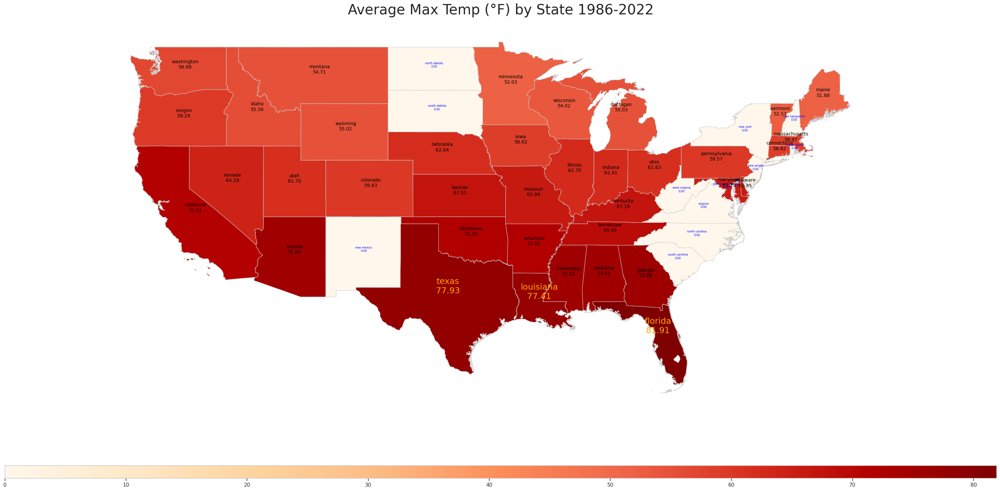

In [23]:
plot_univariate_variable_map(merged_agri_climate_eco_df, shapefile_path, 'Max Temp (°F)')

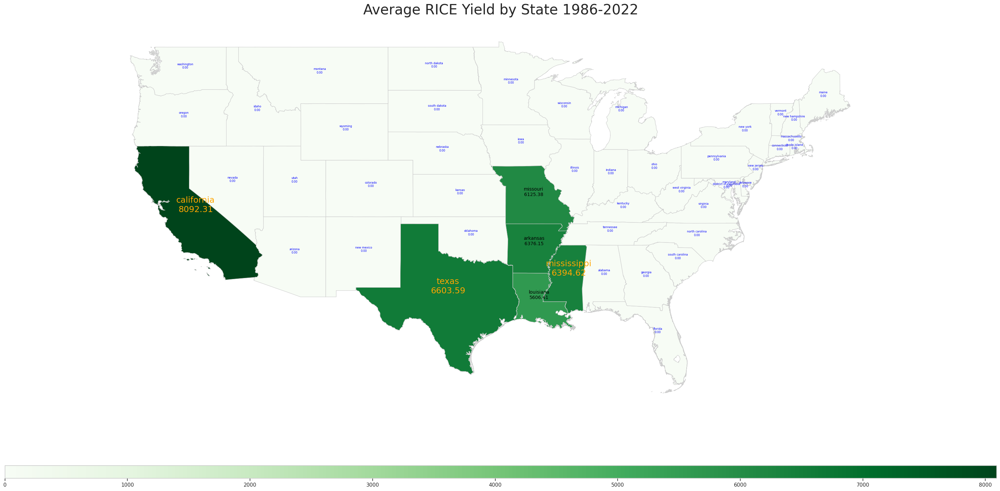

In [24]:
# Here we plot the specific Wheat Yield
plot_univariate_variable_map(merged_agri_climate_eco_df, shapefile_path, 'Yield', specific_yield='RICE')

In [25]:
merged_agri_climate_eco_df['Commodity'].unique()

array(['WHEAT', 'CORN', 'COTTON', 'POTATOES', 'BEANS', 'RICE', 'TOMATOES'],
      dtype=object)

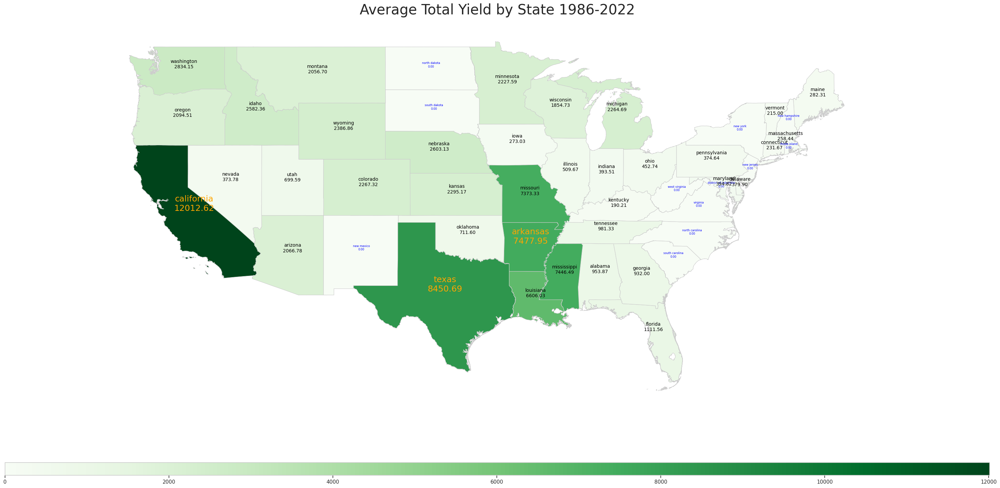

In [26]:
# Here we plot the general Yield.
plot_univariate_variable_map(merged_agri_climate_eco_df, shapefile_path, 'Yield', specific_yield=None)

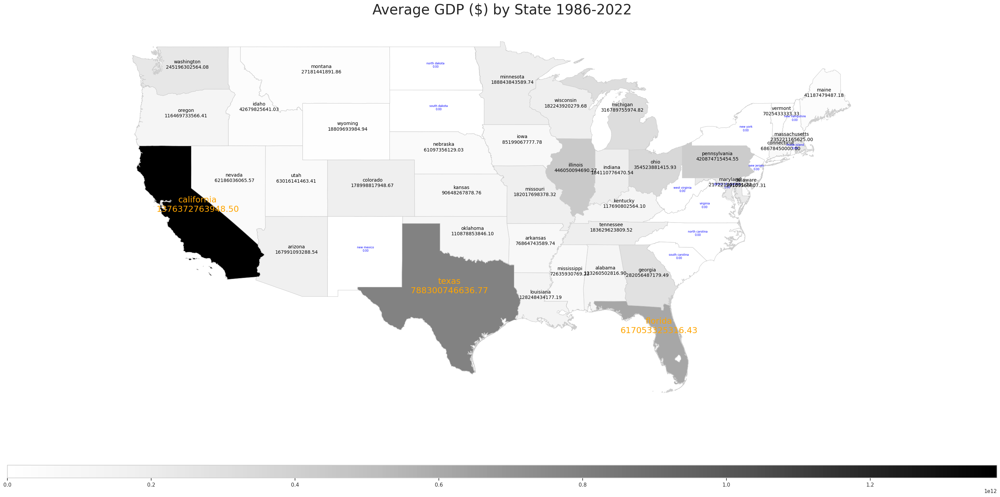

In [27]:
plot_univariate_variable_map(merged_agri_climate_eco_df, shapefile_path, "GDP ($)")

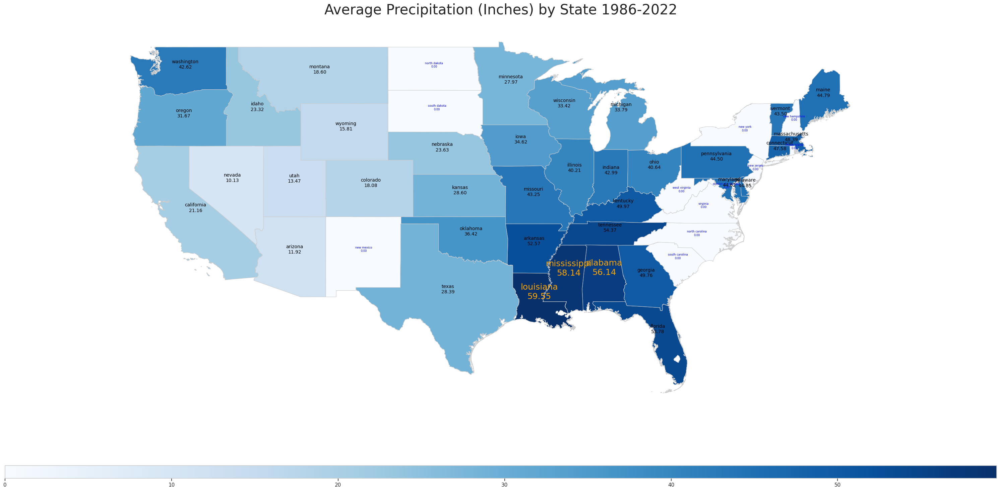

In [28]:
plot_univariate_variable_map(merged_agri_climate_eco_df, shapefile_path, "Precipitation (Inches)")

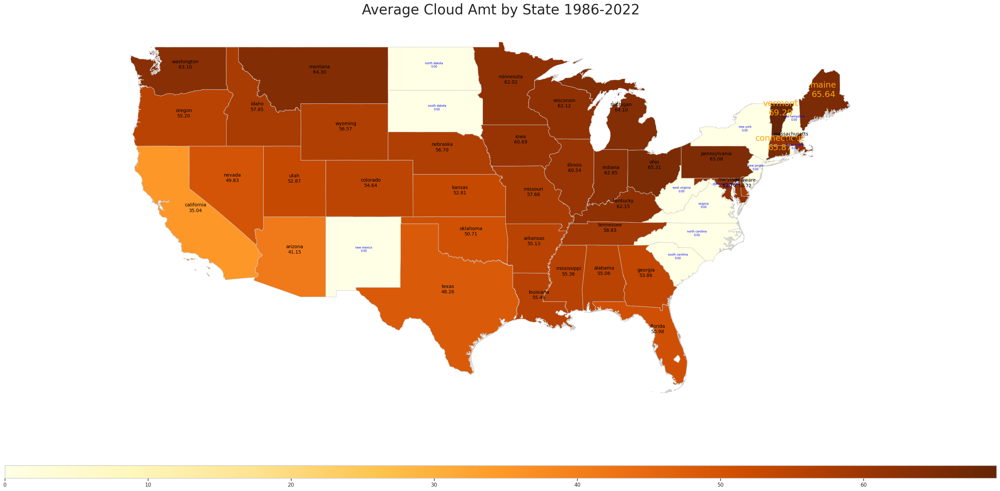

In [29]:
plot_univariate_variable_map(merged_agri_climate_eco_df, shapefile_path, "Cloud Amt")

## 3.3 Yield Time Series Plot

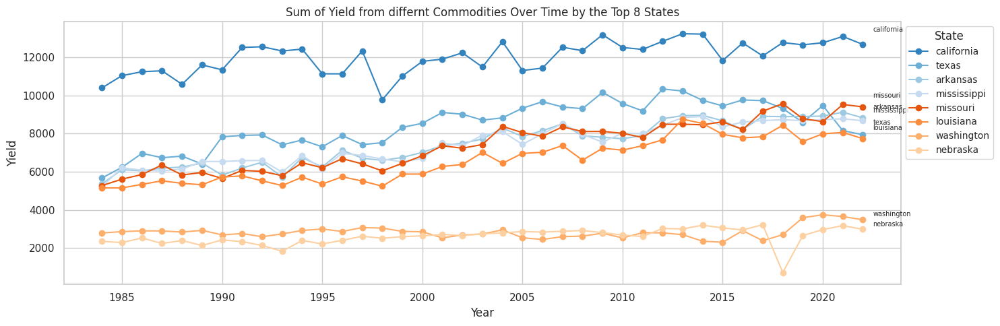

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def plot_top_states_total_yield(df, num_states=10):
    """
    Plots the sum of Yield over time for the top `num_states` states based on total Yield.

    Parameters:
    - df: DataFrame containing the data.
    - num_states: Number of top states to plot based on total Yield. Default is 10.
    """
    # Ensure 'Year' is treated as a numeric type
    df['Year'] = pd.to_numeric(df['Year'], errors='coerce')

    # Group by State and Year and calculate the sum of Yield
    grouped_df = df.groupby(['State', 'Year'])['Yield'].sum().reset_index()

    # Calculate the total Yield for each state to determine the top states
    top_states = grouped_df.groupby('State')['Yield'].sum().nlargest(num_states).index.tolist()

    # Filter the dataframe to only include the top states
    filtered_df = grouped_df[grouped_df['State'].isin(top_states)]

    # Set up the plot
    plt.figure(figsize=(15, 5))

    # Define a list of distinct colors
    colors = plt.get_cmap('tab20c').colors

    # Plot each state's data with a unique color
    for idx, state in enumerate(top_states):
        df_state = filtered_df[filtered_df['State'] == state]
        color = colors[idx % len(colors)]  # Cycle through colors if there are more than 10 states
        plt.plot(df_state['Year'], df_state['Yield'], label=state, marker='o', linestyle='-', color=color)

        # Add the state name at the end of the line with a slight offset for clarity
        offset_x = 0.5  # Adjust this value based on your data to move the text right
        offset_y = 0.05 * df_state['Yield'].max()  # Adjust this value based on your data to move the text up
        plt.text(df_state['Year'].iloc[-1] + offset_x, df_state['Yield'].iloc[-1] + offset_y, state, fontsize=7)

    # Add titles and labels
    plt.title(f'Sum of Yield from differnt Commodities Over Time by the Top {num_states} States')
    plt.xlabel('Year')
    plt.ylabel('Yield')

    # Add a legend to distinguish the states
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1), title='State', fontsize='small')

    # Add grid for better readability
    plt.grid(True)

    # Adjust layout to fit the legend
    plt.tight_layout()

    # Show the plot
    plt.show()

# Example usage with a hypothetical DataFrame
plot_top_states_total_yield(merged_agri_climate_eco_df, num_states=8)


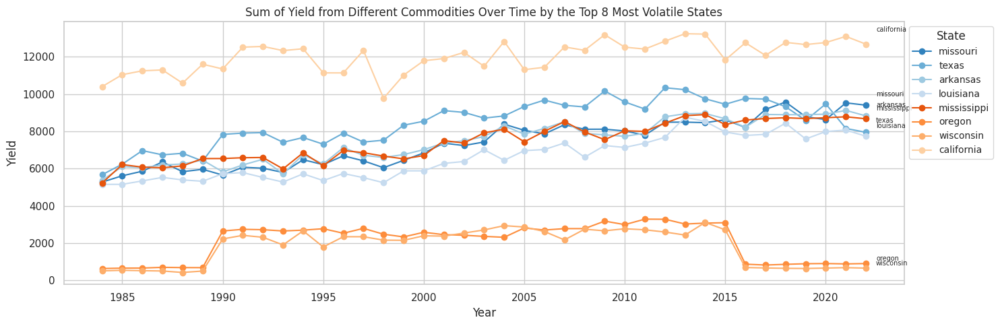

In [31]:
def plot_top_states_by_volatility(df, num_states=10):
    """
    Plots the sum of Yield over time for the top `num_states` states based on Yield volatility (standard deviation),
    with each state having a different color.

    Parameters:
    - df: DataFrame containing the data.
    - num_states: Number of top states to plot based on Yield volatility. Default is 10.
    """
    # Ensure 'Year' is treated as a numeric type
    df['Year'] = pd.to_numeric(df['Year'], errors='coerce')

    # Group by State and Year and calculate the sum of Yield
    grouped_df = df.groupby(['State', 'Year'])['Yield'].sum().reset_index()

    # Calculate the standard deviation of Yield for each state to determine the most volatile states
    volatility = grouped_df.groupby('State')['Yield'].std()

    # Select top states based on volatility (highest standard deviation)
    top_volatile_states = volatility.nlargest(num_states).index.tolist()

    # Filter the dataframe to only include the top volatile states
    filtered_df = grouped_df[grouped_df['State'].isin(top_volatile_states)]

    # Set up the plot
    plt.figure(figsize=(15, 5))

    # Define a list of distinct colors from the 'tab20c' colormap
    colors = plt.get_cmap('tab20c').colors

    # Plot each state's data with a unique color
    for idx, state in enumerate(top_volatile_states):
        df_state = filtered_df[filtered_df['State'] == state]
        color = colors[idx % len(colors)]  # Cycle through colors if there are more than 20 states
        plt.plot(df_state['Year'], df_state['Yield'], label=state, marker='o', linestyle='-', color=color)

        # Add the state name at the end of the line with a slight offset for clarity
        offset_x = 0.5  # Adjust this value based on your data to move the text right
        offset_y = 0.05 * df_state['Yield'].max()  # Adjust this value based on your data to move the text up
        plt.text(df_state['Year'].iloc[-1] + offset_x, df_state['Yield'].iloc[-1] + offset_y, state, fontsize=7)

    # Add titles and labels
    plt.title(f'Sum of Yield from Different Commodities Over Time by the Top {num_states} Most Volatile States')
    plt.xlabel('Year')
    plt.ylabel('Yield')

    # Add a legend to distinguish the states
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1), title='State', fontsize='small')

    # Add grid for better readability
    plt.grid(True)

    # Adjust layout to fit the legend
    plt.tight_layout()

    # Show the plot
    plt.show()

# Example usage with a hypothetical DataFrame
plot_top_states_by_volatility(merged_agri_climate_eco_df, num_states=8)


# 4. Bivariate Analysis

## 4.0 Plot correlation heatmap.

In [ ]:
def plot_heatmap(df, commodity_type=None):
    # Define relevant numeric columns
    numeric_columns = ['Yield', 'GDP ($)', 'Population', 'Income ($)',
                       'Civilian Non-Institutional Pop in State', 'Labor Force in State',
                       'State Area Pop Rate', 'Employment in State', 'Employed Rate',
                       'Unemployment in State', 'Unemployed Rate',
                       'Acres Harvested', 'Production ($)', 'Avg Temp (°F)',
                       'Cooling Days (°F)', 'Heating Days (°F)', 'Max Temp (°F)',
                       'PDSI', 'PHDI', 'PMDI', 'Z-Index',
                       'Precipitation (Inches)', 'Allsky Sfc Sw Dwn', 'Allsky Srf Alb',
                       'Cloud Amt', 'Clrsky Sfc Sw Dwn', 'Gwetprof', 'Gwetroot', 'Gwettop',
                       'Ps', 'Qv2M', 'Rh2M', 'T2Mdew', 'T2Mwet', 'Toa Sw Dwn', 'Ts', 'Wd10M',
                       'Wd2M', 'Ws10M', 'Ws2M']

    # Filter by commodity if specified
    if commodity_type:
        df = df[df['Commodity'] == commodity_type]

    # Select only the numeric columns
    df_numeric = df[numeric_columns]

    # Compute the correlation matrix
    correlation_matrix = df_numeric.corr()

    # Plot the heatmap
    plt.figure(figsize=(20, 15))
    sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=0.5, annot_kws={"size": 8})
    plt.title(f'Heatmap of Correlation Matrix for Commodity: {commodity_type}' if commodity_type else 'Heatmap of Correlation Matrix')
    plt.xticks(fontsize=8)
    plt.yticks(fontsize=8)
    plt.show()

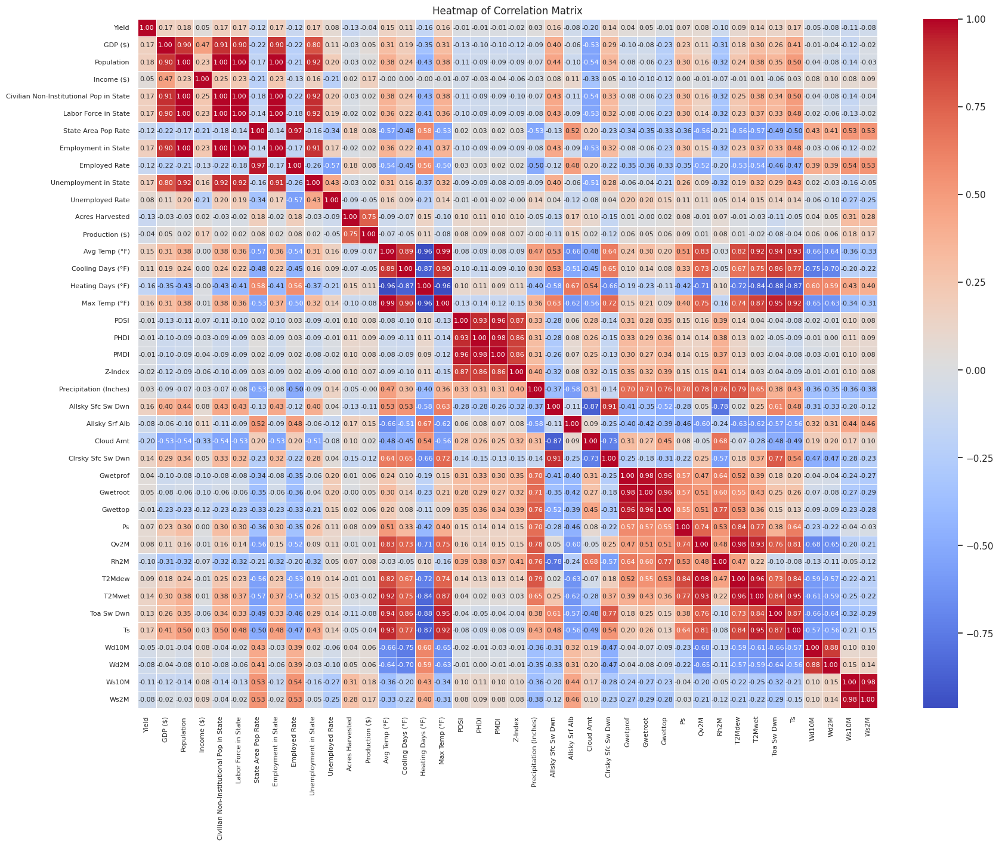

In [ ]:
plot_heatmap(merged_agri_climate_eco_df, commodity_type=None)

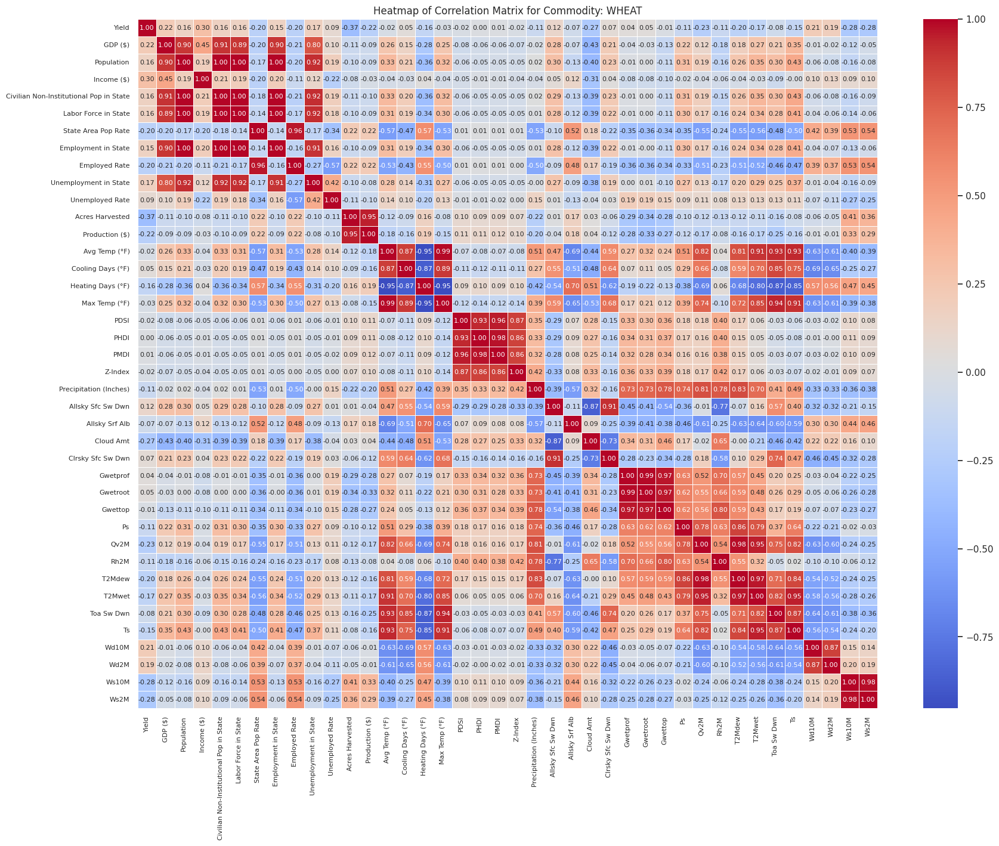

In [ ]:
plot_heatmap(merged_agri_climate_eco_df, commodity_type='WHEAT')

## 4.1 Scatter Plot between Yield and each independent variable.

In [32]:
# Define your columns
climate_vars = ['Avg Temp (°F)', 'Cooling Days (°F)', 'Heating Days (°F)', 'Max Temp (°F)',
                'Min Temp (°F)', 'PDSI', 'PHDI', 'PMDI', 'Z-Index', 'Precipitation (Inches)',
                'Allsky Sfc Sw Dwn', 'Allsky Srf Alb', 'Cloud Amt', 'Clrsky Sfc Sw Dwn', 'Gwetprof',
                'Gwetroot', 'Gwettop', 'Ps', 'Qv2M', 'Rh2M', 'T2Mdew', 'T2Mwet', 'Toa Sw Dwn',
                'Ts', 'Wd10M', 'Wd2M', 'Ws10M', 'Ws2M']

economic_vars = ['GDP ($)', 'Population', 'Income ($)', 'Civilian Non-Institutional Pop in State',
                 'Labor Force in State', 'State Area Pop Rate', 'Employment in State',
                 'Employed Rate', 'Unemployment in State', 'Unemployed Rate']

###  Scatter Plot between Yield and each independent variable - without takeing average of all the States for each year.(Can be ignored)

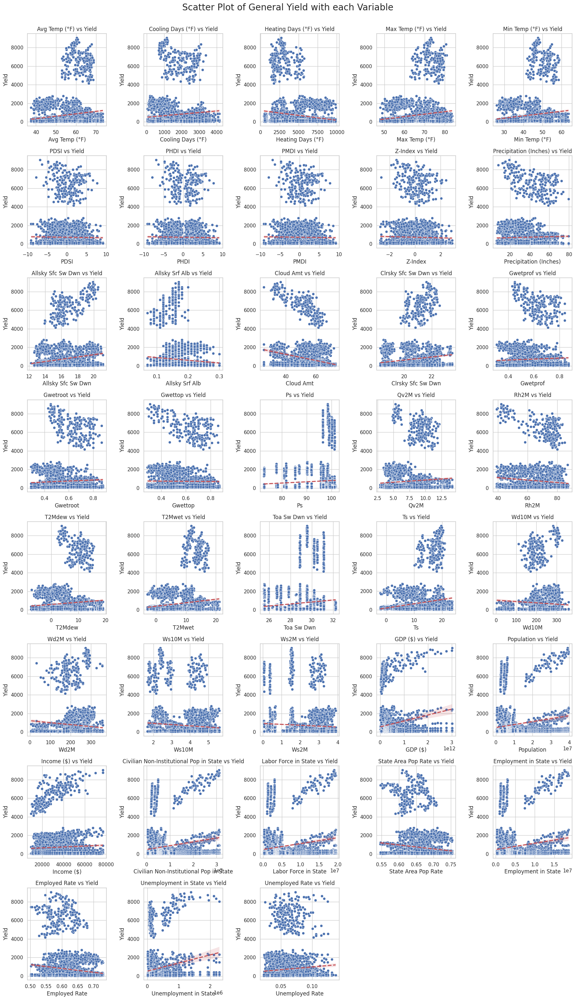

In [198]:
def plot_yield_vs_variables(df, climate_vars, economic_vars, dependent_var='Yield', commodity=None):
    # Filter the DataFrame by commodity if provided
    if commodity:
        df = df[df['Commodity'] == commodity]

    # Define the number of rows and columns for the subplots
    num_vars = len(climate_vars) + len(economic_vars)
    num_cols = 5
    num_rows = (num_vars + num_cols - 1) // num_cols  # Ceiling division

    # Create the subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(18, 4 * num_rows))
    axes = axes.flatten()

    # Plot each climate variable against the dependent variable
    for i, var in enumerate(climate_vars + economic_vars):
        sns.scatterplot(x=df[var], y=df[dependent_var], ax=axes[i])
        sns.regplot(x=df[var], y=df[dependent_var], ax=axes[i], scatter=False, color='r', line_kws={"linestyle":"--"})
        axes[i].set_title(f'{var} vs {dependent_var}')
        axes[i].set_xlabel(var)
        axes[i].set_ylabel(dependent_var)

    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    # Adjust layout to accommodate the plots
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    # Set the main title using fig.text()
    if commodity:
        fig.text(0.5, 0.96, f'Scatter Plot of {commodity} Yield with each Variable', ha='center', fontsize=20)
    else:
        fig.text(0.5, 0.96, 'Scatter Plot of General Yield with each Variable', ha='center', fontsize=20)

    plt.show()

# Example usage:
plot_yield_vs_variables(merged_agri_climate_eco_df, climate_vars, economic_vars)


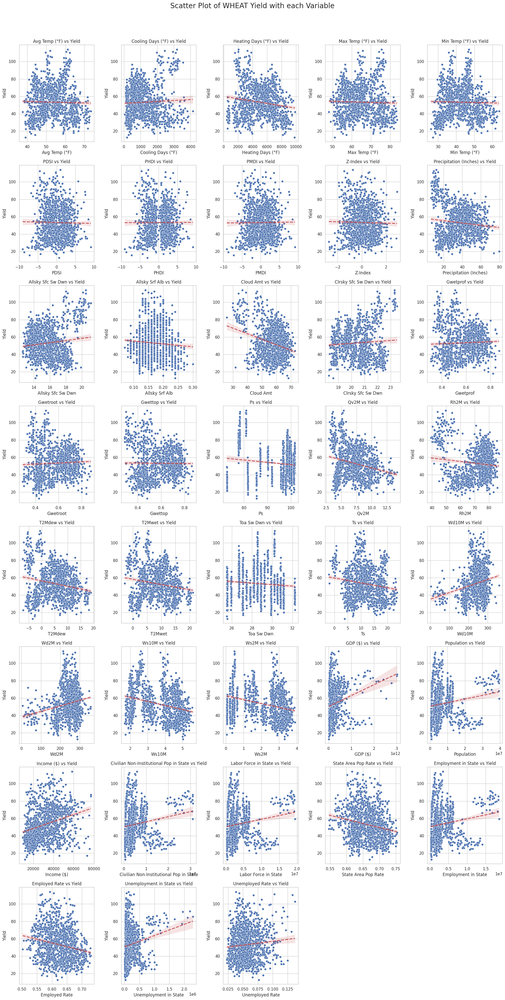

In [ ]:
plot_yield_vs_variables(merged_agri_climate_eco_df, climate_vars, economic_vars, commodity='WHEAT')

### Scatter Plot between Yield and each independent variable - takeing average of all the States for each year. (Can be ignored)

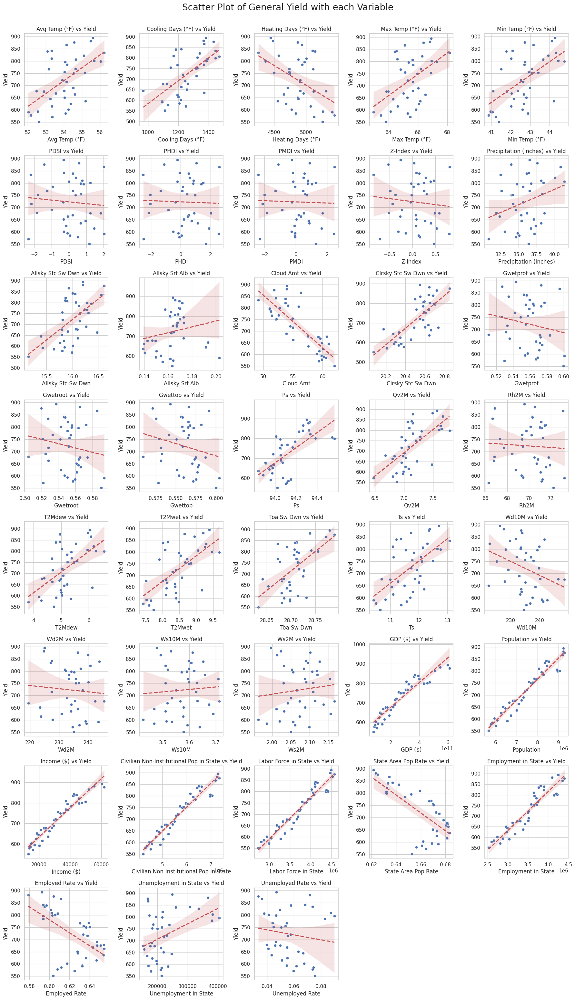

In [199]:
def plot_yield_vs_variables(df, climate_vars, economic_vars, dependent_var='Yield', commodity=None):
    # Filter the DataFrame by commodity if provided
    if commodity:
        df = df[df['Commodity'] == commodity]

    # Group by Year and calculate the mean for each year, excluding non-numeric columns
    numeric_df = df.drop(columns=['State', 'Commodity'])
    grouped_df = numeric_df.groupby('Year').mean().reset_index()

    # Define the number of rows and columns for the subplots
    num_vars = len(climate_vars) + len(economic_vars)
    num_cols = 5
    num_rows = (num_vars + num_cols - 1) // num_cols  # Ceiling division

    # Create the subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(18, 4 * num_rows))
    axes = axes.flatten()

    # Plot each climate variable against the dependent variable
    for i, var in enumerate(climate_vars + economic_vars):
        sns.scatterplot(x=grouped_df[var], y=grouped_df[dependent_var], ax=axes[i])
        sns.regplot(x=grouped_df[var], y=grouped_df[dependent_var], ax=axes[i], scatter=False, color='r', line_kws={"linestyle":"--"})
        axes[i].set_title(f'{var} vs {dependent_var}')
        axes[i].set_xlabel(var)
        axes[i].set_ylabel(dependent_var)

    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    # Adjust layout to accommodate the plots
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    # Set the main title using fig.text()
    if commodity:
        fig.text(0.5, 0.96, f'Scatter Plot of {commodity} Yield with each Variable', ha='center', fontsize=20)
    else:
        fig.text(0.5, 0.96, 'Scatter Plot of General Yield with each Variable', ha='center', fontsize=20)

    plt.show()

# Example usage:
plot_yield_vs_variables(merged_agri_climate_eco_df, climate_vars, economic_vars)


In [171]:
plot_yield_vs_variables(merged_agri_climate_eco_df, climate_vars, economic_vars, commodity='WHEAT')

NameError: name 'plot_yield_vs_variables' is not defined

### 4.1.1 Scatter Plot between Yield and each independent variable - Without takeing average of all the States for each year & plotting each commodity type at a glance.

In [203]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def plot_yield_vs_variables(df, climate_vars, economic_vars, dependent_var='Yield', commodity=None):
    # Filter the DataFrame by commodity if provided
    if commodity:
        df = df[df['Commodity'] == commodity]

    # Identify unique commodities
    commodities = df['Commodity'].unique()

    # Define the number of rows and columns for the subplots
    all_vars = climate_vars + economic_vars
    num_vars = len(all_vars)
    num_cols = len(commodities)
    num_rows = num_vars

    # Create the subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows))

    # If there is only one commodity, ensure axes is 2D
    if num_cols == 1:
        axes = np.expand_dims(axes, axis=1)

    # Plot each variable against the dependent variable for each commodity
    for i, var in enumerate(all_vars):
        for j, commodity in enumerate(commodities):
            # Filter the DataFrame by commodity
            df_commodity = df[df['Commodity'] == commodity]

            # Scatter plot with regression line
            sns.scatterplot(x=df_commodity[var], y=df_commodity[dependent_var], ax=axes[i, j])
            sns.regplot(x=df_commodity[var], y=df_commodity[dependent_var], ax=axes[i, j], scatter=False, color='r', line_kws={"linestyle":"--"})

            # Set titles and labels
            axes[i, j].set_title(f'{commodity}')
            axes[i, j].set_xlabel(var)
            if j == 0:
                axes[i, j].set_ylabel(dependent_var)
            else:
                axes[i, j].set_ylabel('')

            # Adjust y-axis limits based on the yield values for the current commodity
            y_min = df_commodity[dependent_var].min()
            y_max = df_commodity[dependent_var].max()
            axes[i, j].set_ylim(y_min, y_max)

    # Adjust layout to accommodate the plots
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    # Set the main title using fig.text()
    fig.text(0.5, 0.95, 'Scatter Plot of Yield with Each Variable by Commodity', ha='center', fontsize=24)

    plt.show()

# Example usage:
plot_yield_vs_variables(merged_agri_climate_eco_df, climate_vars, economic_vars)


### 4.1.2 Scatter Plot between Yield and each independent variable - takeing average of all the States for each year & plotting each commodity type at a glance.

In [205]:
def plot_yield_vs_variables(df, climate_vars, economic_vars, dependent_var='Yield', commodity=None):
    # Filter the DataFrame by commodity if provided
    if commodity:
        df = df[df['Commodity'] == commodity]

    # Identify unique commodities
    commodities = df['Commodity'].unique()

    # Define the number of rows and columns for the subplots
    all_vars = climate_vars + economic_vars
    num_vars = len(all_vars)
    num_cols = len(commodities)
    num_rows = num_vars

    # Create the subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows))

    # If there is only one commodity, ensure axes is 2D
    if num_cols == 1:
        axes = np.expand_dims(axes, axis=1)

    # Plot each variable against the dependent variable for each commodity
    for i, var in enumerate(all_vars):
        for j, commodity in enumerate(commodities):
            # Filter the DataFrame by commodity
            df_commodity = df[df['Commodity'] == commodity]

            # Group by Year and calculate the mean for each year, excluding non-numeric columns
            numeric_df = df_commodity.drop(columns=['State', 'Commodity'])
            grouped_df = numeric_df.groupby('Year').mean().reset_index()

            # Scatter plot with regression line
            sns.scatterplot(x=grouped_df[var], y=grouped_df[dependent_var], ax=axes[i, j])
            sns.regplot(x=grouped_df[var], y=grouped_df[dependent_var], ax=axes[i, j], scatter=False, color='r', line_kws={"linestyle":"--"})

            # Set titles and labels
            axes[i, j].set_title(f'{commodity}')
            axes[i, j].set_xlabel(var)
            if j == 0:
                axes[i, j].set_ylabel(dependent_var)
            else:
                axes[i, j].set_ylabel('')

            # Adjust y-axis limits based on the yield values for the current commodity
            y_min = grouped_df[dependent_var].min()
            y_max = grouped_df[dependent_var].max()
            axes[i, j].set_ylim(y_min, y_max)

    # Adjust layout to accommodate the plots
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    # Set the main title using fig.text()
    fig.text(0.5, 0.95, "Scatter Plot of Yield with Each Variable by Commodity (Averaged Across All States for Each Year)", ha='center', fontsize=24)

    plt.show()

# Example usage:
plot_yield_vs_variables(merged_agri_climate_eco_df, climate_vars, economic_vars)


## 4.2 Stratified Analysis
- Comparing relationships between agricultural yield and climate variables across different economic strata.

In [33]:
# Define your columns
climate_vars = ['Avg Temp (°F)', 'Cooling Days (°F)', 'Heating Days (°F)', 'Max Temp (°F)',
                'Min Temp (°F)', 'PDSI', 'PHDI', 'PMDI', 'Z-Index', 'Precipitation (Inches)',
                'Allsky Sfc Sw Dwn', 'Allsky Srf Alb', 'Cloud Amt', 'Clrsky Sfc Sw Dwn', 'Gwetprof',
                'Gwetroot', 'Gwettop', 'Ps', 'Qv2M', 'Rh2M', 'T2Mdew', 'T2Mwet', 'Toa Sw Dwn',
                'Ts', 'Wd10M', 'Wd2M', 'Ws10M', 'Ws2M']

economic_vars = ['GDP ($)', 'Population', 'Income ($)', 'Civilian Non-Institutional Pop in State',
                 'Labor Force in State', 'State Area Pop Rate', 'Employment in State',
                 'Employed Rate', 'Unemployment in State', 'Unemployed Rate']

<ipython-input-38-64d303059fd9>:23: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_sum_yield = df.groupby(['Year', 'State', 'Economic Strata'])[yield_var].sum().reset_index()
<ipython-input-38-64d303059fd9>:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_agg = df_agg.groupby(['Year', 'Economic Strata'])[numeric_vars].mean().reset_index()


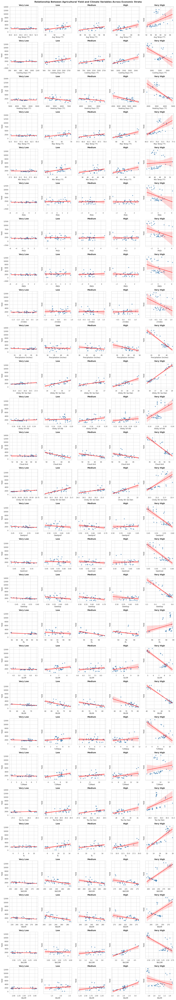

In [38]:
def plot_stratified_analysis(df, economic_var, climate_vars, yield_var='Yield'):
    """
    Plot relationships between agricultural yield and climate variables
    across different economic strata.

    Parameters:
    df (pd.DataFrame): The input dataframe containing all the data.
    economic_var (str): The name of the economic variable to create strata (e.g., 'GDP ($)').
    climate_vars (list): A list of climate variable names to analyze.
    yield_var (str): The name of the yield variable (default is 'Yield').

    Returns:
    None: The function displays plots.
    """

    # Ensure economic variable is numeric
    df[economic_var] = pd.to_numeric(df[economic_var], errors='coerce')

    # Create economic strata based on quantiles (5 strata instead of 3)
    df['Economic Strata'] = pd.qcut(df[economic_var], 5, labels=['Very Low', 'Low', 'Medium', 'High', 'Very High'])

    # Sum Yield across all commodities for each Year, State, and Economic Stratum
    df_sum_yield = df.groupby(['Year', 'State', 'Economic Strata'])[yield_var].sum().reset_index()

    # Merge climate variables without aggregation
    df_climate = df[climate_vars + ['Year', 'State', 'Economic Strata']].drop_duplicates()
    df_agg = df_sum_yield.merge(df_climate, on=['Year', 'State', 'Economic Strata'])

    # Aggregate by Year and Economic Strata
    numeric_vars = [yield_var] + climate_vars
    df_agg = df_agg.groupby(['Year', 'Economic Strata'])[numeric_vars].mean().reset_index()

    # Set up the grid of subplots
    num_vars = len(climate_vars)
    fig, axes = plt.subplots(num_vars, 5, figsize=(18, num_vars * 4), sharey='row')

    # Apply a seaborn theme with a color palette
    sns.set(style="whitegrid", palette="husl")

    # If there is only one row of subplots, axes might be a 1D array
    if num_vars == 1:
        axes = axes.reshape(1, -1)

    for i, var in enumerate(climate_vars):
        for j, stratum in enumerate(['Very Low', 'Low', 'Medium', 'High', 'Very High']):
            # Subset the data for the current economic stratum
            subset = df_agg[df_agg['Economic Strata'] == stratum]
            # Create a scatter plot with regression line and enhanced aesthetics
            sns.regplot(ax=axes[i, j], data=subset, x=var, y=yield_var, scatter_kws={'s':30, 'alpha':0.7, 'color':'#4682B4'}, line_kws={'color':'red', 'linewidth':2})
            axes[i, j].set_title(f'{stratum}', fontsize=14, weight='bold')
            if j == 0:
                axes[i, j].set_ylabel(f'{yield_var}', fontsize=12)
            if i == num_vars - 1:
                axes[i, j].set_xlabel(var, fontsize=12)

    # Adjust layout and show plot
    plt.tight_layout(rect=[0, 0.03, 1, 0.93])

    fig.text(0.5, 0.93, 'Relationship Between Agricultural Yield and Climate Variables Across Economic Strata', ha='center', fontsize=16, weight='bold')

    plt.show()


# Example usage
plot_stratified_analysis(merged_agri_climate_eco_df, 'GDP ($)', climate_vars)
